> Igor Sorochan DSU-31

# Decision tree.

In [1]:
from sklearn.datasets import fetch_california_housing as fch
import pandas as pd
import numpy as np

from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import StandardScaler
from sklearn.tree import DecisionTreeRegressor

# try:
#   import dtreeviz
# except:
#   !pip install dtreeviz
#   import dtreeviz

import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.tree import plot_tree
from sklearn import tree
import graphviz   
import dtreeviz

In [2]:
# !pip install dtreeviz

### Loading data set

In [3]:
data = fch() 
print(data.DESCR)

.. _california_housing_dataset:

California Housing dataset
--------------------------

**Data Set Characteristics:**

    :Number of Instances: 20640

    :Number of Attributes: 8 numeric, predictive attributes and the target

    :Attribute Information:
        - MedInc        median income in block group
        - HouseAge      median house age in block group
        - AveRooms      average number of rooms per household
        - AveBedrms     average number of bedrooms per household
        - Population    block group population
        - AveOccup      average number of household members
        - Latitude      block group latitude
        - Longitude     block group longitude

    :Missing Attribute Values: None

This dataset was obtained from the StatLib repository.
https://www.dcc.fc.up.pt/~ltorgo/Regression/cal_housing.html

The target variable is the median house value for California districts,
expressed in hundreds of thousands of dollars ($100,000).

This dataset was derived

#### Attribute Information:

* MedInc median income in block group

* HouseAge median house age in block group

* AveRooms average number of rooms per household

* AveBedrms average number of bedrooms per household

* Population block group population

* AveOccup average number of household members

* Latitude block group latitude

* Longitude block group longitude

## EDA
### Prepare

In [4]:
cols = data.feature_names       # list of column names
cols

['MedInc',
 'HouseAge',
 'AveRooms',
 'AveBedrms',
 'Population',
 'AveOccup',
 'Latitude',
 'Longitude']

The target variable is the median house value for California districts,
expressed in hundreds of `thousands of dollars ($100,000)`.

In [5]:
target = data.target           # target variable
target

array([4.526, 3.585, 3.521, ..., 0.923, 0.847, 0.894])

In [6]:
df = pd.DataFrame(data.data, columns=cols)  # create dataframe
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20640 entries, 0 to 20639
Data columns (total 8 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   MedInc      20640 non-null  float64
 1   HouseAge    20640 non-null  float64
 2   AveRooms    20640 non-null  float64
 3   AveBedrms   20640 non-null  float64
 4   Population  20640 non-null  float64
 5   AveOccup    20640 non-null  float64
 6   Latitude    20640 non-null  float64
 7   Longitude   20640 non-null  float64
dtypes: float64(8)
memory usage: 1.3 MB


In [7]:
pd.DataFrame(target).describe().T   # target variable summary

,count,mean,std,min,25%,50%,75%,max
0,20640.0,2.068558,1.153956,0.14999,1.196,1.797,2.64725,5.00001


The upper limit for median house value is fixed on $500,000.  
Are there really no houses with higher prices?  
It seems strange.

### Basic cleaning
#### Duplicates
No duplicates

In [8]:
df.duplicated().sum()  # check for duplicates

0

#### Nans
No nans

In [9]:
df.isna().sum().any() # check for missing values

False

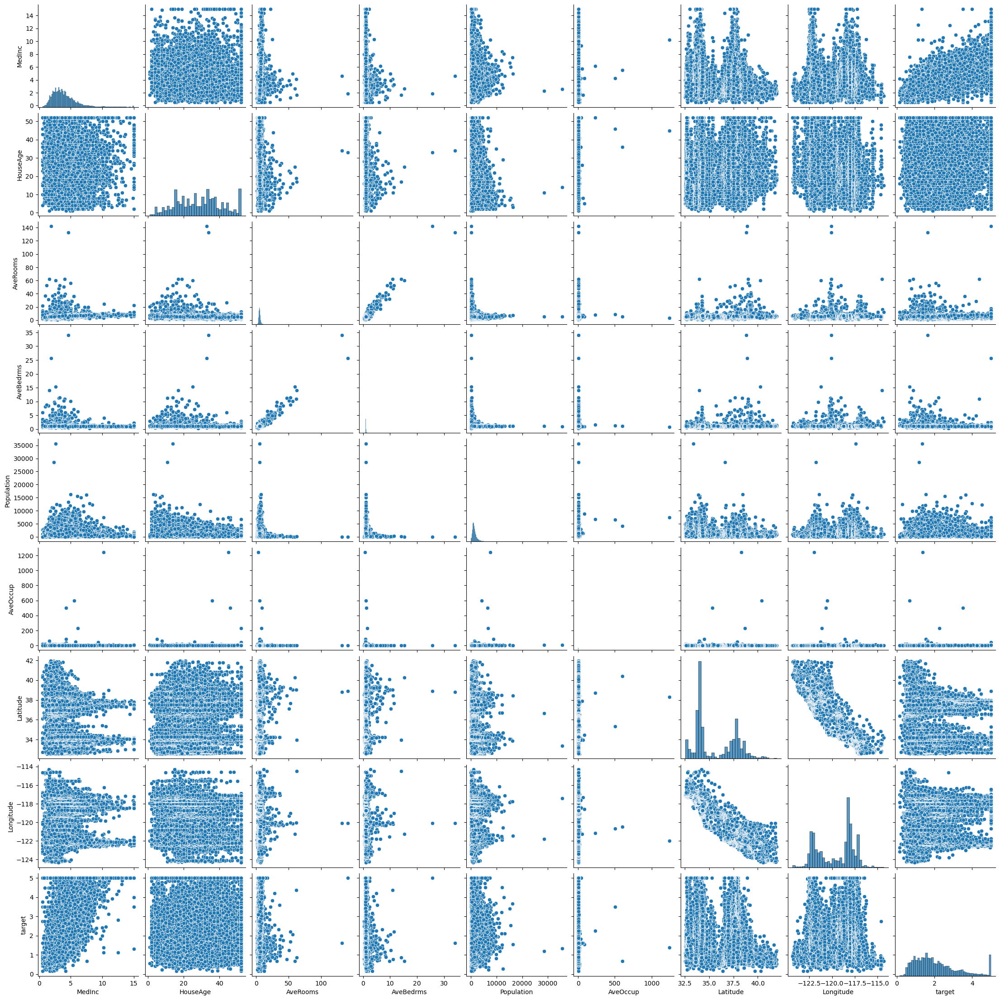

In [10]:
sns.pairplot(pd.concat([df, pd.DataFrame(target, columns=['target'])], axis=1))
plt.show()

We can notice that the target variable does not have a normal distribution.  
In addition, there is some anomaly in all target value plots,  
which can be seen as if the data was clipped at the top.

**The coefficient of determination $R^2$** is defined as
$(1 - \frac{u}{v})$,  
where $u$ is the residual sum of squares $ \sum_{i=1}^{n}(y_{true,i}-y_{pred,i})^2$  

and $v$ is the total sum of squares      $\sum_ (y_{true} - \hat y_{true}) ^ 2$.  
The best possible score is 1.0 and it can be negative (because the
model can be arbitrarily worse). 
A constant model that always predicts the expected value of `y`,  
disregarding the input features, would get
a  $R^2$ score of 0.0.

Let's run LR model "from the box" with Standard Scaler.

In [11]:
results = {}          # dictionary to store results

In [12]:
X_train, X_test, y_train, y_test = train_test_split(df, target, test_size=0.2, random_state=42)

lr = LinearRegression()
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)
  
lr.fit(X_train, y_train)
r2 = lr.score(X_test, y_test) 
rmse = mean_squared_error(y_test, lr.predict(X_test), squared = False)

results = {'LR From the box': [r2, rmse]}
print(f'R2 score "from the box": {r2:.4}')
print(f'RMSE "from the box": {rmse:.4}')

R2 score "from the box": 0.5758
RMSE "from the box": 0.7456


#### Let's predict a single value.

In [13]:
x_to_predict = X_test[0:1, :]                   # first row of the training set
prediction = lr.predict(x_to_predict)           # predicting the value and reversing log transformation
print(f'LR Predicted value: {prediction[0]:.4}')# printing the result
print(f'Actual value: {y_test[0]}')             # printing the actual value from the training set with reversed log transformation

LR Predicted value: 0.7191
Actual value: 0.477


Decision Tree 

In [14]:
dt_regr = DecisionTreeRegressor(max_depth=4, random_state=42)
dt_regr.fit(X_train, y_train)
r2 = dt_regr.score(X_test, y_test)
rmse = mean_squared_error(y_test, dt_regr.predict(X_test), squared = False)

results['Decision tree regr depth=4']= [r2, rmse]
print(f'R2 score "dt_clf": {r2:.4}')
print(f'RMSE "DT clf": {rmse:.4}')

R2 score "dt_clf": 0.554
RMSE "DT clf": 0.7645


In [15]:
dt_regr = DecisionTreeRegressor(max_depth=4, random_state=42)

X = df[target < 5 ]                                 # removing outliers  
X_train, X_test, y_train, y_test = train_test_split(X, np.log(target[X.index]), test_size=0.2, random_state=42)
# splitting data into train and test sets and log-transforming target

dt_regr.fit(X_train, y_train)
r2 = dt_regr.score(X_test, y_test)
rmse = mean_squared_error(y_test, dt_regr.predict(X_test), squared = False)

results['DT regr depth=4 outliers removed, log(target)']= [r2, rmse]
print(f'R2 score: {r2:.4}')
print(f'RMSE : {rmse:.4}')

R2 score: 0.5748
RMSE : 0.3488


In [16]:
dt_regr = DecisionTreeRegressor(max_depth=4, random_state=42)

X = df[target < 5 ]                                 # removing outliers  
X_train, X_test, y_train, y_test = train_test_split(X, np.log(target[X.index]), test_size=0.2, random_state=42)
# splitting data into train and test sets and log-transforming target

scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

dt_regr.fit(X_train, y_train)
r2 = dt_regr.score(X_test, y_test)
rmse = mean_squared_error(y_test, dt_regr.predict(X_test), squared = False)

results['DT regr depth=4 outliers removed, log(target) Stand Scaler']= [r2, rmse]
print(f'R2 score: {r2:.4}')
print(f'RMSE : {rmse:.4}')

R2 score: 0.5748
RMSE : 0.3488


The results with Standard scaler are actually the same as without preprocessing.

In [17]:
dt_regr = DecisionTreeRegressor(max_depth=6, random_state=42)

X = df[target < 5 ]                                 # removing outliers  
X_train, X_test, y_train, y_test = train_test_split(X, np.log(target[X.index]), test_size=0.2, random_state=42)
# splitting data into train and test sets and log-transforming target

dt_regr.fit(X_train, y_train)
r2 = dt_regr.score(X_test, y_test)
rmse = mean_squared_error(y_test, dt_regr.predict(X_test), squared = False)

results['DT regr depth=6 outliers removed, log(target)']= [r2, rmse]
print(f'R2 score: {r2:.4}')
print(f'RMSE : {rmse:.4}')

R2 score: 0.6379
RMSE : 0.3219


#### Let's predict a single value.

In [18]:
X_train.iloc[0:1, :]

,MedInc,HouseAge,AveRooms,AveBedrms,Population,AveOccup,Latitude,Longitude
12794,1.6607,20.0,4.625,0.984756,1287.0,3.92378,38.64,-121.46


In [19]:
x_to_predict = X_train.iloc[0:1, :]                   # first row of the training set
prediction = np.exp(dt_regr.predict(x_to_predict))    # predicting the value and reversing log transformation
print(f'DT Predicted value: {prediction[0]:.4}')         # printing the result
print(f'Actual value: {np.exp(y_train[0])}')          # printing the actual value from the training set with reversed log transformation

DT Predicted value: 0.8241
Actual value: 0.67


In [20]:
dt_regr = DecisionTreeRegressor(max_depth=3, random_state=42)
dt_regr.fit(X_train, y_train)
r2 = dt_regr.score(X_test, y_test)
rmse = mean_squared_error(y_test, dt_regr.predict(X_test), squared = False)

results['Decision tree regr depth=3']= [r2, rmse]
print(f'R2 score "dt_clf": {r2:.4}')
print(f'RMSE "DT clf": {rmse:.4}')

R2 score "dt_clf": 0.4921
RMSE "DT clf": 0.3812


In [21]:
pd.DataFrame(results, index=['R2 score', 'RMSE']).T.sort_values(by='RMSE', ascending=True).style.bar( color='lightgreen')

,R2 score,RMSE
"DT regr depth=6 outliers removed, log(target)",0.637863,0.321888
"DT regr depth=4 outliers removed, log(target)",0.574783,0.348798
"DT regr depth=4 outliers removed, log(target) Stand Scaler",0.574783,0.348798
Decision tree regr depth=3,0.492123,0.381196
LR From the box,0.575788,0.745581
Decision tree regr depth=4,0.554029,0.764464


### Decision Tree Visualizations

#### `dtreeviz.model`

This package:  
* shows the distribution of decision feature in the each node
* shows the class-color matching legend
* shows the distribution of the class in the leaf in case of classification tasks, and `mean` of the leaf’s reponse in the case of regression tasks

In [22]:
viz_model = dtreeviz.model(dt_regr, X_train, y_train,
                target_name= "The median house value",
                feature_names= data.feature_names)

# v = viz_model.view()     # render as SVG into internal object 
# v.show()                 # pop up window with SVG

# viz.save("decision_tree.svg")
viz_model.view()

/Users/velo1/opt/anaconda3/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but DecisionTreeRegressor was fitted with feature names


To visualize larger trees, we can reduce the amount of detail by turning off the fancy view:

In [23]:
viz_model.view(fancy=False)

##### Prediction path explanations

For interpretation purposes, we often want to understand how a tree behaves for a specific instance. Let's pick a specific instance:

In [24]:
x = X_train.iloc[0, :]
x

MedInc           1.660700
HouseAge        20.000000
AveRooms         4.625000
AveBedrms        0.984756
Population    1287.000000
AveOccup         3.923780
Latitude        38.640000
Longitude     -121.460000
Name: 12794, dtype: float64

In [25]:
viz_model.view(x=x)

In [26]:
viz_model.view(x=x, show_just_path=True)    # show only the path to the leaf

We can also get a string representation explaining the comparisons made as an instance is run down the tree:

In [29]:
print(viz_model.explain_prediction_path(x))

MedInc < 3.13
34.45 <= Latitude 
-121.73 <= Longitude 



Use `instance_feature_importance()` to visualize the feature importance for a specific instance:

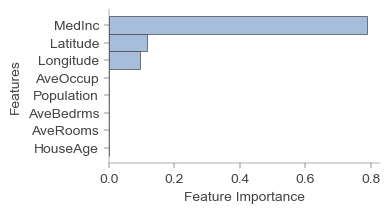

In [30]:
viz_model.instance_feature_importance(x, figsize=(3.5,2))

##### Visualize leaf target distributions for regression (classification) decision trees.

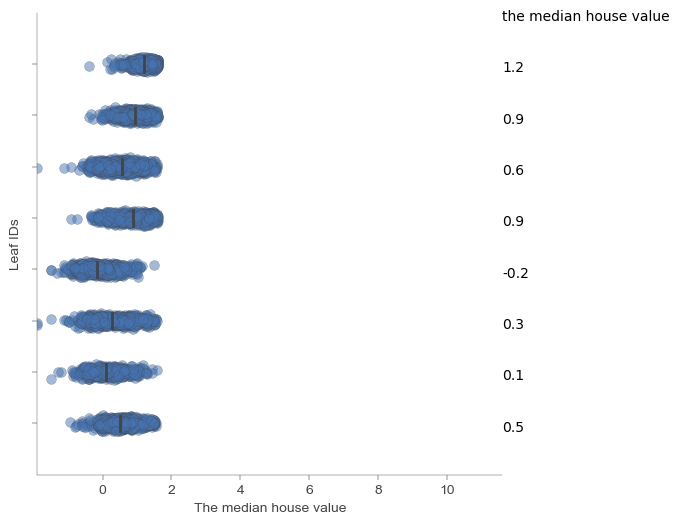

In [35]:
# viz_model.ctree_leaf_distributions(figsize=(3.5,2))   # distribution of target values in each leaf for CLASSIFICATION trees
viz_model.rtree_leaf_distributions(figsize= (6,6) )     # distribution of target values in each leaf for REGRESSION trees

#### Visualize Decision Tree with `graphviz`

To plot the trees we need to export it to DOT format with export_graphviz method (link to docs).  
Then we can plot it in the notebook or save to the file.

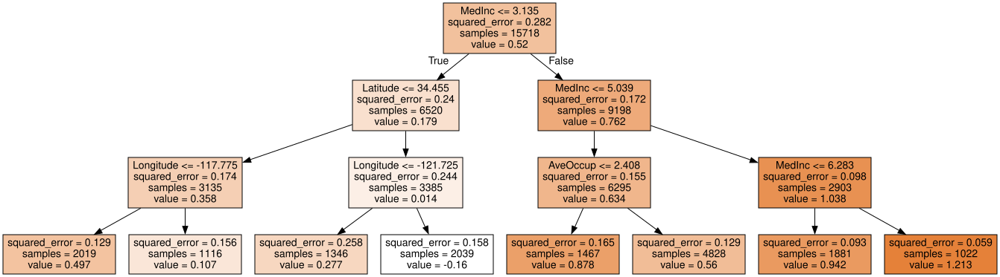

In [27]:
dot_data = tree.export_graphviz(dt_regr, out_file=None, 
                                feature_names=data.feature_names,  
                                # class_names=iris.target_names,
                                filled=True)

# Draw graph
graph = graphviz.Source(dot_data, format="png")   # format="png" or "pdf"
graph

#### Plot Tree with `plot_tree`

The `plot_tree` is a method in the sklearn library for plotting decision trees that have been trained using the DecisionTreeClassifier or DecisionTreeRegressor classes.  
It generates a graphical representation of the tree, which can be useful for understanding how the tree works and for visualizing the decision-making process.  

It allows us to easily produce figure of the tree (without intermediate exporting to graphviz).  
The more information about plot_tree arguments are in the [docs](https://scikit-learn.org/stable/modules/generated/sklearn.tree.plot_tree.html).

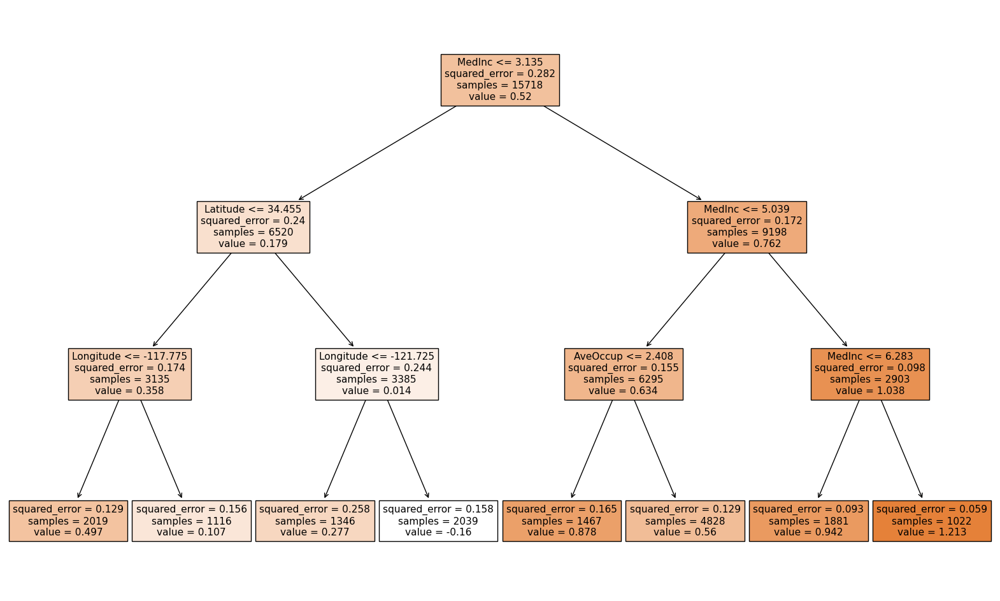

In [28]:
plt.figure(figsize=(20, 12))
plot_tree(dt_regr, feature_names= data.feature_names, filled=True);

* Visualizations of Decision Ttrees with depth 5 and greater are complex to understand.  
* The value in the leaf shows:  

|in case of classification tasks|in the case of regression tasks|
|:---|:---|
| the `distribution` of the class  |  `mean` of the leaf’s reponse |

## Main takeaways


* **Easy to understand and interpret**  This makes them a popular choice for applications where the decisions made by the algorithm need to be explained to stakeholders.

* **Requires little data preparation** Decision trees do not require extensive data preparation, such as normalization or scaling of input features. They can handle both numerical and categorical data, and can also handle missing values.  In our case dt_regr.score with preprosses data was actually lower than raw data.

* **Handles non-linear relationships** Decision trees can capture non-linear relationships between input features and output variables, without the need for complex mathematical transformations.

* **Can be used for classification and regression** Decision trees can be used for both classification and regression problems, making them a versatile algorithm that can be used in many different types of applications.

* **Can handle both continuous and discrete data** Decision trees can handle both continuous and discrete input features, and can also handle mixed data types.

* **Can handle interactions between variables** Decision trees can capture interactions between input features, which can be important for some applications.

* **Robust to outliers** Decision trees are robust to outliers in the input data, as they are based on a series of binary decisions that are not influenced by extreme values.